# 1.1 Парсинг данных

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import requests
import io
from statsmodels.graphics.gofplots import qqplot
from scipy.stats import shapiro
from scipy.stats import normaltest
import scipy.stats as stats
import statsmodels.api as sm

C:\Users\Les\AppData\Local\Temp\ipykernel_17152\1067041405.py:1: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


Подключим библиотеки необходимые для работы с датасетом и построения графиков.

In [2]:
pd.options.display.max_columns = None

Настроим pandas на вывод всех колонок с параметрами

In [3]:
pd.options.display.max_rows = None

Настроим pandas на вывод всех строк с параметрами

In [4]:
df = pd.read_csv('https://raw.githubusercontent.com/owid/covid-19-data/master/public/data/owid-covid-data.csv')
#df = pd.read_csv('owid-covid-data.csv')

Загрузим данные github

In [5]:
df.head(10)

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_cases_per_million,new_cases_per_million,new_cases_smoothed_per_million,total_deaths_per_million,new_deaths_per_million,new_deaths_smoothed_per_million,reproduction_rate,icu_patients,icu_patients_per_million,hosp_patients,hosp_patients_per_million,weekly_icu_admissions,weekly_icu_admissions_per_million,weekly_hosp_admissions,weekly_hosp_admissions_per_million,total_tests,new_tests,total_tests_per_thousand,new_tests_per_thousand,new_tests_smoothed,new_tests_smoothed_per_thousand,positive_rate,tests_per_case,tests_units,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,total_boosters_per_hundred,new_vaccinations_smoothed_per_million,new_people_vaccinated_smoothed,new_people_vaccinated_smoothed_per_hundred,stringency_index,population_density,median_age,aged_65_older,aged_70_older,gdp_per_capita,extreme_poverty,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,population,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million
0,AFG,Asia,Afghanistan,2020-01-05,NaN,0.0,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,54.422,18.6,2.581,1.337,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
1,AFG,Asia,Afghanistan,2020-01-06,NaN,0.0,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,54.422,18.6,2.581,1.337,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
2,AFG,Asia,Afghanistan,2020-01-07,NaN,0.0,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,54.422,18.6,2.581,1.337,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
3,AFG,Asia,Afghanistan,2020-01-08,NaN,0.0,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,54.422,18.6,2.581,1.337,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
4,AFG,Asia,Afghanistan,2020-01-09,NaN,0.0,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,54.422,18.6,2.581,1.337,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
5,AFG,Asia,Afghanistan,2020-01-10,NaN,0.0,0.0,NaN,0.0,0.0,NaN,0.0,0.0,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,54.422,18.6,2.581,1.337,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
6,AFG,Asia,Afghanistan,2020-01-11,NaN,0.0,0.0,NaN,0.0,0.0,NaN,0.0,0.0,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,54.422,18.6,2.581,1.337,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
7,AFG,Asia,Afghanistan,2020-01-12,NaN,0.0,0.0,NaN,0.0,0.0,NaN,0.0,0.0,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,54.422,18.6,2.581,1.337,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
8,AFG,Asia,Afghanistan,2020-01-13,NaN,0.0,0.0,NaN,0.0,

Вывод первых десяти данных показал наличе записей типа object и float, имеются пустые и нулевые значения.

# <font color='red'>---------------------------------------------------------------------------------------------------------------------------</font> 

Необходимо оставить 60% данных датасета равномерно по дате. Для этого используем следующий алгоритм

In [6]:
df["date"] = pd.to_datetime(df["date"])

In [7]:
print(len(df))
sample_sizes = {}
for name, group in df.groupby(df["date"].dt.to_period("M")):
    sample_size = int(len(group) * 0.4)
    sample_sizes[name] = sample_size

sample_df = df.groupby(df["date"].dt.to_period("M")).apply(lambda x: x.sample(n=sample_sizes[x.name], replace = False))

sample_df = sample_df.reset_index(drop=True)
print(len(sample_df))

383698
153459


Выведем первые десять позиций обновленного датафрейма, чтобы увидеть отличия

In [8]:
sample_df.head()

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_cases_per_million,new_cases_per_million,new_cases_smoothed_per_million,total_deaths_per_million,new_deaths_per_million,new_deaths_smoothed_per_million,reproduction_rate,icu_patients,icu_patients_per_million,hosp_patients,hosp_patients_per_million,weekly_icu_admissions,weekly_icu_admissions_per_million,weekly_hosp_admissions,weekly_hosp_admissions_per_million,total_tests,new_tests,total_tests_per_thousand,new_tests_per_thousand,new_tests_smoothed,new_tests_smoothed_per_thousand,positive_rate,tests_per_case,tests_units,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,total_boosters_per_hundred,new_vaccinations_smoothed_per_million,new_people_vaccinated_smoothed,new_people_vaccinated_smoothed_per_hundred,stringency_index,population_density,median_age,aged_65_older,aged_70_older,gdp_per_capita,extreme_poverty,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,population,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million
0,CYM,North America,Cayman Islands,2020-01-07,NaN,0.0,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,256.496,NaN,NaN,NaN,49903.029,NaN,NaN,13.22,NaN,NaN,NaN,NaN,83.92,NaN,68722.0,NaN,NaN,NaN,NaN
1,IRL,Europe,Ireland,2020-01-22,NaN,0.0,0.0,NaN,0.0,0.0,NaN,0.0,0.0,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.00,69.874,38.7,13.928,8.678,67335.293,0.2,126.459,3.28,23.0,25.7,NaN,2.960,82.30,0.955,5023108.0,NaN,NaN,NaN,NaN
2,ROU,Europe,Romania,2020-01-27,NaN,0.0,0.0,NaN,0.0,0.0,NaN,0.0,0.0,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.78,85.129,43.0,17.850,11.690,23313.199,5.7,370.946,9.74,22.9,37.1,NaN,6.892,76.05,0.828,19659270.0,NaN,NaN,NaN,NaN
3,ATG,North America,Antigua and Barbuda,2020-01-22,NaN,0.0,0.0,NaN,0.0,0.0,NaN,0.0,0.0,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,231.845,32.1,6.933,4.631,21490.943,NaN,191.511,13.17,NaN,NaN,NaN,3.800,77.02,0.778,93772.0,NaN,NaN,NaN,NaN
4,DOM,North America,Dominican Republic,2020-01-10,NaN,0.0,0.0,NaN,0.0,0.0,NaN,0.0,0.0,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.00,222.873,27.6,6.981,4.419,14600.861,1.6,266.653,8.20,8.5,19.1,55.182,1.600,74.08,0.756,11228821.0,NaN,NaN,NaN,NaN


In [9]:
df["total_cases"]

0                 NaN
1                 NaN
2                 NaN
3                 NaN
4                 NaN
5                 NaN
6                 NaN
7                 NaN
8                 NaN
9                 NaN
10                NaN
11                NaN
12                NaN
13                NaN
14                NaN
15                NaN
16                NaN
17                NaN
18                NaN
19                NaN
20                NaN
21                NaN
22                NaN
23                NaN
24                NaN
25                NaN
26                NaN
27                NaN
28                NaN
29                NaN
30                NaN
31                NaN
32                NaN
33                NaN
34                NaN
35                NaN
36                NaN
37                NaN
38                NaN
39                NaN
40                NaN
41                NaN
42                NaN
43                NaN
44                NaN
45        

In [10]:
df["continent"].unique()

array(['Asia', nan, 'Europe', 'Africa', 'Oceania', 'North America',
       'South America'], dtype=object)

In [11]:
df.columns

Index(['iso_code', 'continent', 'location', 'date', 'total_cases', 'new_cases',
       'new_cases_smoothed', 'total_deaths', 'new_deaths',
       'new_deaths_smoothed', 'total_cases_per_million',
       'new_cases_per_million', 'new_cases_smoothed_per_million',
       'total_deaths_per_million', 'new_deaths_per_million',
       'new_deaths_smoothed_per_million', 'reproduction_rate', 'icu_patients',
       'icu_patients_per_million', 'hosp_patients',
       'hosp_patients_per_million', 'weekly_icu_admissions',
       'weekly_icu_admissions_per_million', 'weekly_hosp_admissions',
       'weekly_hosp_admissions_per_million', 'total_tests', 'new_tests',
       'total_tests_per_thousand', 'new_tests_per_thousand',
       'new_tests_smoothed', 'new_tests_smoothed_per_thousand',
       'positive_rate', 'tests_per_case', 'tests_units', 'total_vaccinations',
       'people_vaccinated', 'people_fully_vaccinated', 'total_boosters',
       'new_vaccinations', 'new_vaccinations_smoothed',
       't

# <font color='red'>---------------------------------------------------------------------------------------------------------------------------</font> 

# 1.2 Предобработка данных и выделение значимых атрибутов

### Разведочный анализ данных (РАД, EDA)

In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 383698 entries, 0 to 383697
Data columns (total 67 columns):
 #   Column                                      Non-Null Count   Dtype         
---  ------                                      --------------   -----         
 0   iso_code                                    383698 non-null  object        
 1   continent                                   365374 non-null  object        
 2   location                                    383698 non-null  object        
 3   date                                        383698 non-null  datetime64[ns]
 4   total_cases                                 344917 non-null  float64       
 5   new_cases                                   372892 non-null  float64       
 6   new_cases_smoothed                          371662 non-null  float64       
 7   total_deaths                                322777 non-null  float64       
 8   new_deaths                                  373187 non-null  float64      

Датафрейм включает в себя 67 параметров и 350084 записей, среди которых присутствуют пустые значения, 62 параметра имеют тип данных float, 5 параметров имеют тип данных object, вес файла 179 мб

In [13]:
# выводим типы данных
df.dtypes

iso_code                                              object
continent                                             object
location                                              object
date                                          datetime64[ns]
total_cases                                          float64
new_cases                                            float64
new_cases_smoothed                                   float64
total_deaths                                         float64
new_deaths                                           float64
new_deaths_smoothed                                  float64
total_cases_per_million                              float64
new_cases_per_million                                float64
new_cases_smoothed_per_million                       float64
total_deaths_per_million                             float64
new_deaths_per_million                               float64
new_deaths_smoothed_per_million                      float64
reproduction_rate       

Датафрейм включает в себя 67 параметров, 62 параметра имеют тип данных float, 5 параметров имеют тип данных object

In [14]:
df.describe().T

,count,mean,min,25%,50%,75%,max,std
date,383698,2022-02-02 05:58:40.174720512,2020-01-01 00:00:00,2021-01-20 00:00:00,2022-02-02 00:00:00,2023-02-15 00:00:00,2024-03-13 00:00:00,NaN
total_cases,344917.0,7326393.93134,1.0,9251.0,78700.0,841469.0,774824101.0,43712459.234296
new_cases,372892.0,8806.666847,0.0,0.0,0.0,0.0,44236227.0,240789.800893
new_cases_smoothed,371662.0,8835.320124,0.0,0.0,17.571,411.571,6319461.0,90792.517714
total_deaths,322777.0,89617.134266,1.0,135.0,1390.0,12517.0,7036104.0,455244.332021
new_deaths,373187.0,78.825257,0.0,0.0,0.0,0.0,103719.0,1430.951001
new_deaths_smoothed,371957.0,79.078719,0.0,0.0,0.143,4.143,14817.0,536.769135
total_cases_per_million,344917.0,111435.417056,0.0,2936.913,32178.218,154388.893,764960.958,159315.26091
new_cases_per_million,372892.0,133.745437,0.0,0.0,0.0,0.0,240325.866,1551.258171
new_cases_smoothed_per_million,371662.0,134.180714,0.0,0.0,4.38,69.551,34332.267,573.993282


Вывели информацию о численных типах данных, из которых видно наличие пропущенных значений у некоторых параметров. Присутствуют отрицательные минимальные значения, которые, скорее всего, являются выбросами. Присутствуют излишне большие максимальные значения, которые, скорее всего, являются выбросами. Проверим процент пропущенных значений создадим список, в котором будут хранится параметры для дальнейшего удаления.

In [15]:
#Найдём и выведем колонки, где пропущенных значений больше 70%
DeletedColumns=[]
for col in df.columns:
    if type(df[col]) != object:   
        print(col)
        print("Количество пропущенных значении - {}%".format((df[col].isna().mean()*100).round(2)))
        print()
        print("---------------------------------------------")
        print()
        if(df[col].isna().mean()>0.70):
            DeletedColumns.append(col)
print("параметры, которые имеют больше 70% процентов пропусков", DeletedColumns)

        

iso_code
Количество пропущенных значении - 0.0%

---------------------------------------------

continent
Количество пропущенных значении - 4.78%

---------------------------------------------

location
Количество пропущенных значении - 0.0%

---------------------------------------------

date
Количество пропущенных значении - 0.0%

---------------------------------------------

total_cases
Количество пропущенных значении - 10.11%

---------------------------------------------

new_cases
Количество пропущенных значении - 2.82%

---------------------------------------------

new_cases_smoothed
Количество пропущенных значении - 3.14%

---------------------------------------------

total_deaths
Количество пропущенных значении - 15.88%

---------------------------------------------

new_deaths
Количество пропущенных значении - 2.74%

---------------------------------------------

new_deaths_smoothed
Количество пропущенных значении - 3.06%

---------------------------------------------

tot

В датафрейме присутствует огромное количество параметров с пустыми значения, позже можно будет убрать следующие параметры, пропущенные значения которых превышают 70% : 'icu_patients', 'icu_patients_per_million', 'hosp_patients', 'hosp_patients_per_million', 'weekly_icu_admissions', 'weekly_icu_admissions_per_million', 'weekly_hosp_admissions', 'weekly_hosp_admissions_per_million', 'total_tests', 'new_tests', 'total_tests_per_thousand', 'new_tests_per_thousand', 'new_tests_smoothed', 'new_tests_smoothed_per_thousand', 'positive_rate', 'tests_per_case', 'total_vaccinations', 'people_vaccinated', 'people_fully_vaccinated', 'total_boosters', 'new_vaccinations', 'total_vaccinations_per_hundred', 'people_vaccinated_per_hundred', 'people_fully_vaccinated_per_hundred', 'total_boosters_per_hundred', 'excess_mortality_cumulative_absolute', 'excess_mortality_cumulative', 'excess_mortality', 'excess_mortality_cumulative_per_million'

In [16]:
corr = df.corr(numeric_only=True)

Преобразуем наши данные в корреляционную матрицу.

<Axes: >

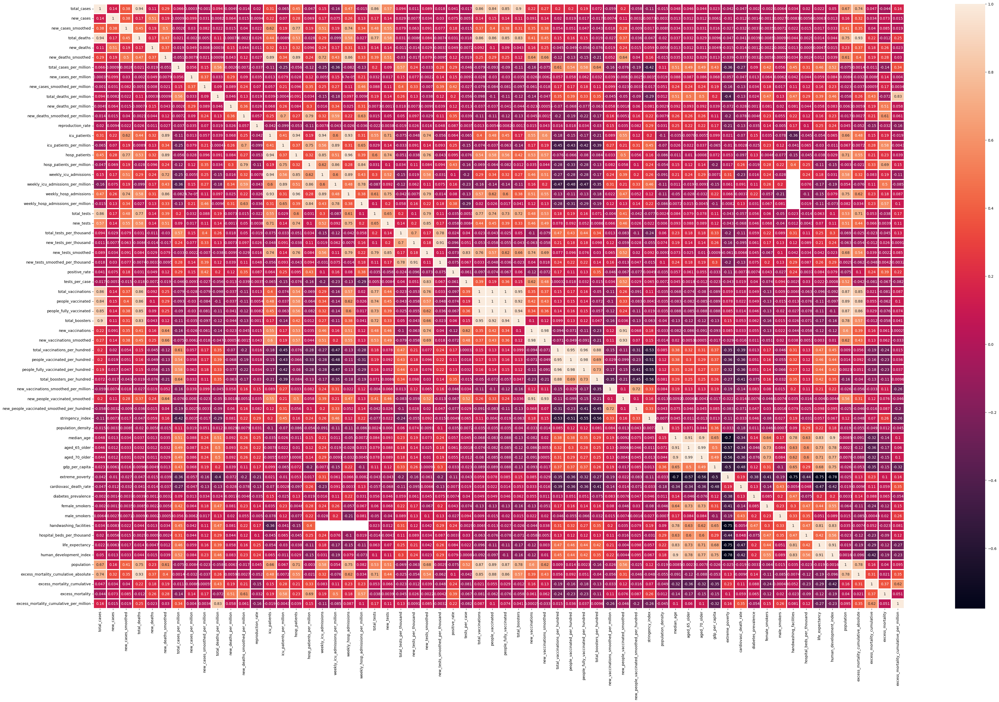

In [17]:
plt.figure(figsize=(50,30))
sns.heatmap(corr, annot = True, linewidths=1.5 )

На основе тепловой карты уберем параметры коррелируют больше чем 0.8 и меньше чем 0.7, не будем учитывать параметры, которые имели большое количество пропущенных строк. Будут удалены след-ие параметры: 
1) extreme_poverty отрицательно коррелирует с life_expectancy и Human_development_index (лучше оставить life_expectancy и Human_development_index, так как это позволит оставить оба параметра)
2) total_deaths положительно коррелирует с total_cases (решено оставить tottal_cases, так как он определяет и количество смертей и показывает заразность болезни в регионе)
3) new_cases положительно коррелирует c new_cases_smoothed (решено оставить new_cases_smoothed, так как там встречается меньше выбросов)
4) aged_65_older и aged_70_older положительно коррелируют с median_age (решено оставить median_age, так как он даёт более полную информацию о возрасте чем aged_65_older или aged_70_older, которые также положительно коррелируют между собой)
5) life_expectancy положительно коррелирует c Human_development_index (решено оставить Human_development_index, так как он определяет продолжительность жизни и показывает насколько страна способна разрабатывать и производить новые виды вакцины)
6) new_vaccinations_smoothed положительно коррелирует new_vaccinations (решено оставить new_vaccinations_smoothed, так как там встречается меньше выбросов)

Добавим данные параметры в список для дальнейшего удаления.

In [18]:
DeletedColumns.append("extreme_poverty")
DeletedColumns.append("total_deaths")
DeletedColumns.append("new_cases")
DeletedColumns.append("aged_65_older")
DeletedColumns.append("aged_70_older")
DeletedColumns.append("life_expectancy")
DeletedColumns.append("new_vaccinations_smoothed")

### Дополнительные атрибуты

На данный момент ввод дополнительных переменных не требуется

# 1.3 Описание структуры набора данных

#### Подтвержденные случаи заболевания
total_cases - Всего подтвержденных случаев COVID-19. Подсчеты могут включать вероятные случаи, если о них сообщалось.

new_cases - Новые подтвержденные случаи Covid-19. Подсчеты могут включать вероятные случаи, если о них сообщалось. В редких случаях, когда наш источник сообщает об отрицательном ежедневном изменении из-за корректировки данных, мы устанавливаем для этого показателя значение NA.

new_cases_smoothed - Новые подтвержденные случаи COVID-19 (сглаженные за 7 дней). Подсчеты могут включать вероятные случаи, если о них сообщалось.

total_cases_per_million - Общее количество подтвержденных случаев COVID-19 на 1 000 000 человек. Подсчеты могут включать вероятные случаи, если о них сообщалось.

new_cases_per_million - Новые подтвержденные случаи COVID-19 на 1 000 000 человек. Подсчеты могут включать вероятные случаи, если о них сообщалось.

new_cases_smoothed_per_million - Новые подтвержденные случаи COVID-19 (сглаженные за 7 дней) на 1 000 000 человек. Подсчеты могут включать вероятные случаи, если о них сообщалось.

#### Подтвержденные случаи смерти
total_deaths - Всего смертей от Covid-19. Подсчеты могут включать вероятные случаи смерти, если об этом сообщается.

new_deaths - Новые случаи смерти от Covid-19. Подсчеты могут включать вероятные случаи смерти, если об этом сообщается. В редких случаях, когда наш источник сообщает об отрицательном ежедневном изменении из-за корректировки данных, мы устанавливаем для этого показателя значение NA.

new_deaths_smoothed	- Новые случаи смерти, связанные с COVID-19 (сглаженные за 7 дней). Подсчеты могут включать вероятные случаи смерти, если об этом сообщается.

total_deaths_per_million - Общее количество смертей от Covid-19 на 1 000 000 человек. Подсчеты могут включать вероятные случаи смерти, если об этом сообщается.

new_deaths_per_million - Новые случаи смерти от Covid-19 на 1 000 000 человек. Подсчеты могут включать вероятные случаи смерти, если об этом сообщается.

new_deaths_smoothed_per_million	- Новые случаи смерти от COVID-19 (сглаженные за 7 дней) на 1 000 000 человек. Подсчеты могут включать вероятные случаи смерти, если об этом сообщается.

#### Повышенная смертность
excess_mortality - Процентная разница между зарегистрированным количеством смертей за неделю или месяц в 2020–2021 годах и прогнозируемым количеством смертей за тот же период на основе предыдущих лет.

excess_mortality_cumulative	- Процентная разница между совокупным числом смертей с 1 января 2020 года и совокупным прогнозируемым числом смертей за тот же период на основе предыдущих лет.

excess_mortality_cumulative_absolute - Кумулятивная разница между зарегистрированным числом смертей с 1 января 2020 года и прогнозируемым числом смертей за тот же период на основе предыдущих лет.

excess_mortality_cumulative_per_million - Кумулятивная разница между зарегистрированным числом смертей с 1 января 2020 года и прогнозируемым числом смертей за тот же период на основе предыдущих лет, на миллион человек.

#### Больница и отделение интенсивной терапии
icu_patients - Количество пациентов с COVID-19 в отделениях интенсивной терапии (ОИТ) в определенный день

icu_patients_per_million - Число пациентов с COVID-19 в отделениях интенсивной терапии (ОИТ) в определенный день на 1 000 000 человек

hosp_patients - Количество пациентов с COVID-19, находящихся в больнице в определенный день

hosp_patients_per_million - Число пациентов с COVID-19, находящихся в больнице в определенный день на 1 000 000 человек

weekly_icu_admissions - Число пациентов с COVID-19, впервые поступивших в отделения интенсивной терапии (ОИТ) за данную неделю (отчетная дата и предшествующие 6 дней)

weekly_icu_admissions_per_million - Число пациентов с COVID-19, впервые поступивших в отделения интенсивной терапии (ОИТ) за данную неделю на 1 000 000 человек (отчетная дата и предшествующие 6 дней)

weekly_hosp_admissions - Число пациентов с COVID-19, впервые поступивших в больницы за данную неделю (отчетная дата и предыдущие 6 дней)

weekly_hosp_admissions_per_million - Число пациентов с COVID-19, впервые поступивших в больницы за данную неделю, на 1 000 000 человек (отчетная дата и предыдущие 6 дней)

#### Ответные меры политики
stringency_index - Индекс строгости мер реагирования правительства: комплексный показатель, основанный на 9 индикаторах реагирования, включая закрытие школ, рабочих мест и запреты на поездки, масштабированный до значения от 0 до 100 (100 = самый строгий ответ).

#### Скорость воспроизводства
reproduction_rate - Оценка эффективной скорости воспроизводства (R) COVID-19 в реальном времени.

#### Тесты
total_tests	- Всего тестов на COVID-19

new_tests - Новые тесты на COVID-19 (рассчитываются только за последовательные дни)

total_tests_per_thousand - Всего тестов на COVID-19 на 1000 человек

new_tests_per_thousand - Новые тесты на COVID-19 на 1000 человек

new_tests_smoothed - Новые тесты на COVID-19 (сглаженные за 7 дней). Для стран, которые не сообщают данные о тестировании ежедневно, мы предполагаем, что тестирование менялось одинаково ежедневно в течение всех периодов, в течение которых данные не сообщались. В результате получается полная серия ежедневных показателей, которые затем усредняются за скользящий 7-дневный период.

new_tests_smoothed_per_thousand	- Новые тесты на COVID-19 (сглаженные за 7 дней) на 1000 человек

positive_rate - Доля положительных тестов на COVID-19, выраженная как скользящее среднее за 7 дней (это обратное значение test_per_case).

tests_per_case - Тесты, проведенные на каждый новый подтвержденный случай COVID-19, выраженный как скользящее среднее значение за 7 дней (это обратное значение положительного_рейта)

tests_units - Единицы измерения, используемые местоположением для отчета о данных тестирования. Файл страны не может содержать смешанные единицы. Все метрики, касающиеся данных тестирования, используют указанный тестовый блок. Допустимыми единицами измерения являются «протестированные люди» (количество протестированных людей), «проведенные тесты» (количество проведенных тестов. Один человек может проходить тестирование более одного раза в течение определенного дня) и «протестированные образцы» (количество протестированных образцов. В в некоторых случаях для проведения данного испытания может потребоваться более одного образца.)

#### Прививки
total_vaccinations - Общее количество введенных доз вакцины против COVID-19

people_vaccinated - Общее количество людей, получивших хотя бы одну дозу вакцины

people_fully_vaccinated - Общее количество людей, получивших все дозы, предусмотренные протоколом первоначальной вакцинации

total_boosters - Общее количество введенных бустерных доз вакцинации против COVID-19 (введенных доз сверх количества, предусмотренного протоколом вакцинации)

new_vaccinations - Введены новые дозы вакцинации против COVID-19 (рассчитываются только для последовательных дней)

new_vaccinations_smoothed - Введены новые дозы вакцинации против COVID-19 (сглаженные за 7 дней). Для стран, которые не сообщают данные о вакцинации ежедневно, мы предполагаем, что уровень вакцинации менялся одинаково ежедневно в течение всех периодов, в течение которых данные не поступали. В результате получается полная серия ежедневных показателей, которые затем усредняются за скользящий 7-дневный период.

total_vaccinations_per_hundred - Общее количество введенных доз вакцины против COVID-19 на 100 человек в общей численности населения

people_vaccinated_per_hundred - Общее количество людей, получивших хотя бы одну дозу вакцины, на 100 человек общей численности населения

people_fully_vaccinated_per_hundred - Общее количество людей, получивших все дозы, предусмотренные протоколом первичной вакцинации, на 100 человек общей численности населения

total_boosters_per_hundred - Общее количество введенных бустерных доз вакцинации против COVID-19 на 100 человек в общей численности населения

new_vaccinations_smoothed_per_million - Введены новые дозы вакцинации против COVID-19 (сглаженные за 7 дней) на 1 000 000 человек в общей численности населения

new_people_vaccinated_smoothed - Ежедневное количество людей, получающих первую дозу вакцины (сглаженное за 7 дней)

new_people_vaccinated_smoothed_per_hundred - Ежедневное количество людей, получающих первую дозу вакцины (сглаженная за 7 дней) на 100 человек в общей численности населения

#### Другие
iso_code - ISO 3166-1 альфа-3 – трехбуквенные коды стран. Обратите внимание, что регионы, определенные OWID (например, континенты, такие как «Европа»), содержат префикс «OWID_».

continent - Континент географического положения

location - Географическое положение

date - Дата наблюдения

population - Население (последние доступные значения).

population_density - Число людей, разделенное на площадь суши, в квадратных километрах, за последний год, по которому имеются данные.

median_age - Средний возраст населения, прогноз ООН на 2020 год.

aged_65_older - Доля населения в возрасте 65 лет и старше, данные за последний год

aged_70_older - Доля населения в возрасте 70 лет и старше в 2015 г.

gdp_per_capita - Валовой внутренний продукт по паритету покупательной способности (в постоянных международных долларах 2011 года), данные за последний год

extreme_poverty	- Доля населения, живущего в крайней нищете, данные за последний год, начиная с 2010 г.

cardiovasc_death_rate - Смертность от сердечно-сосудистых заболеваний в 2017 г. (годовое число смертей на 100 000 человек)

diabetes_prevalence - Распространенность диабета (% населения в возрасте от 20 до 79 лет) в 2017 г.

female_smokers - Доля курящих женщин, доступные за последний год

male_smokers - Доля курящих мужчин, доступные за последний год

handwashing_facilities - Доля населения, имеющего в помещениях базовые приспособления для мытья рук, данные за последний год, доступные

hospital_beds_per_thousand - Больничные койки на 1000 человек, последний год, доступный с 2010 г.

life_expectancy	- Ожидаемая продолжительность жизни при рождении в 2019 году

human_development_index	- Составной индекс, измеряющий средние достижения по трем основным измерениям человеческого развития — долгой и здоровой жизни, знаниям и достойному уровню жизни. Значения за 2019 год

array([[<Axes: title={'center': 'date'}>,
        <Axes: title={'center': 'total_cases'}>,
        <Axes: title={'center': 'new_cases'}>,
        <Axes: title={'center': 'new_cases_smoothed'}>,
        <Axes: title={'center': 'total_deaths'}>,
        <Axes: title={'center': 'new_deaths'}>,
        <Axes: title={'center': 'new_deaths_smoothed'}>,
        <Axes: title={'center': 'total_cases_per_million'}>],
       [<Axes: title={'center': 'new_cases_per_million'}>,
        <Axes: title={'center': 'new_cases_smoothed_per_million'}>,
        <Axes: title={'center': 'total_deaths_per_million'}>,
        <Axes: title={'center': 'new_deaths_per_million'}>,
        <Axes: title={'center': 'new_deaths_smoothed_per_million'}>,
        <Axes: title={'center': 'reproduction_rate'}>,
        <Axes: title={'center': 'icu_patients'}>,
        <Axes: title={'center': 'icu_patients_per_million'}>],
       [<Axes: title={'center': 'hosp_patients'}>,
        <Axes: title={'center': 'hosp_patients_per_m

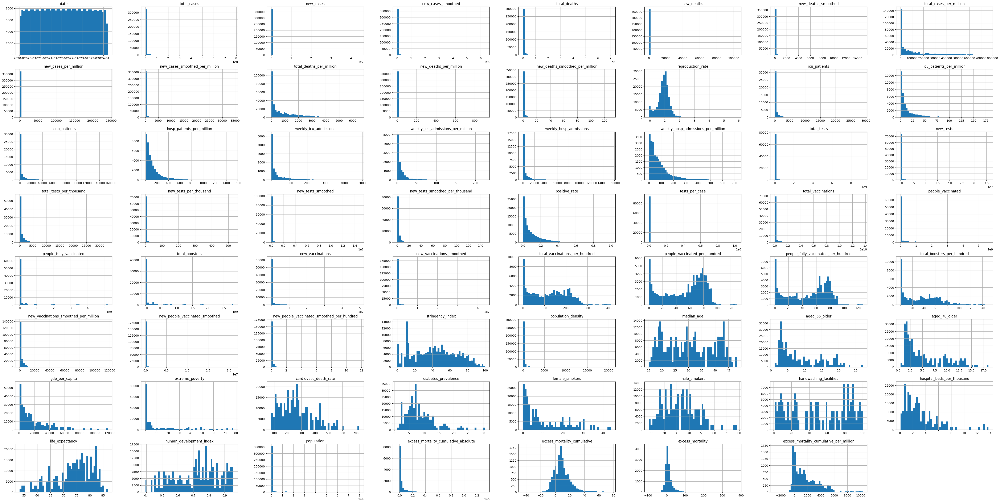

In [19]:
#Выведем гистограмму оставшихся параметров
df.hist(figsize = (60,30), bins = 50)

По графикам распределения плотности можно увидеть, что многие параметры имеют значенимя, которые можно посчитать за выбросы. Проверим следующие параметры на выбросы, даже те которые мы исключили из-за нулевых значений и большой корреляции: total_cases, new_cases, new_cases_smoothed, total_deaths, new_deaths, new_deaths_smoothed, total_cases_per_million, new_cases_per_million, new_cases_smoothed_per_million, new_deaths_per_million,  new_deaths_smoothed_per_million, icu_patients, hosp_patients, weekly_hosp_admissions, total_tests,  new_test, total_tests_per_thousand, new_tests_per_thousand, new_tests_smoothed, new_tests_smoothed_per_thousand, tests_per_case, total_vaccinations, people_vaccinated, people_fully_vaccinated, total_boosters, new_vacciantions, new_vacciantions_smoothed, new_vacciantions_smoothed_per_million, new_people_vaccinated_smoothed, new_people_vaccinated_smoothed_per_hundred, population_density, population.

In [20]:
check_this = ['total_cases',"aged_70_older", 'new_cases', 'new_cases_smoothed', 'total_deaths', 'new_deaths', 'new_deaths_smoothed', 'total_cases_per_million', 'new_cases_per_million', 'new_cases_smoothed_per_million', 'new_deaths_per_million', 'new_deaths_smoothed_per_million', 'icu_patients', 'hosp_patients', 'weekly_hosp_admissions', 'total_tests', 'new_tests', 'total_tests_per_thousand', 'new_tests_per_thousand', 'new_tests_smoothed', 'new_tests_smoothed_per_thousand', 'tests_per_case', 'total_vaccinations', 'people_vaccinated', 'people_fully_vaccinated', 'total_boosters', 'new_vaccinations', 'new_vaccinations_smoothed', 'new_vaccinations_smoothed_per_million', 'new_people_vaccinated_smoothed', 'new_people_vaccinated_smoothed_per_hundred', 'population_density', 'population']

Создадим список со всеми параметрами, у которых мы хотим проверить выбросы

D:\Python\Lib\site-packages\statsmodels\graphics\utils.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure()


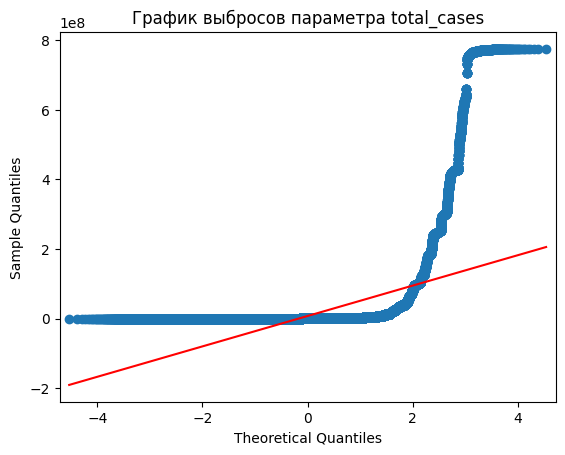

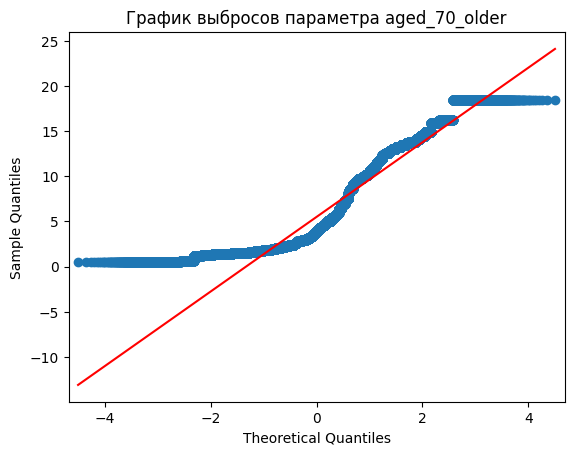

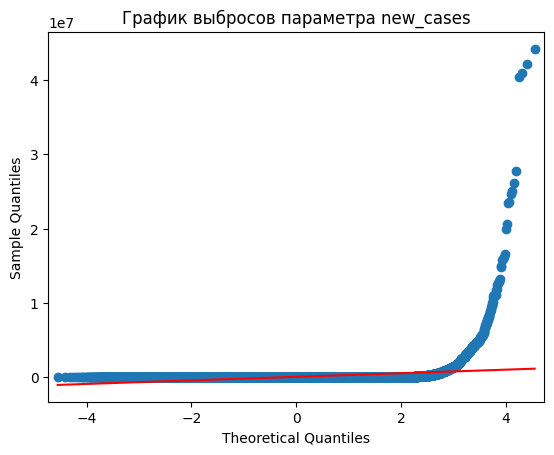

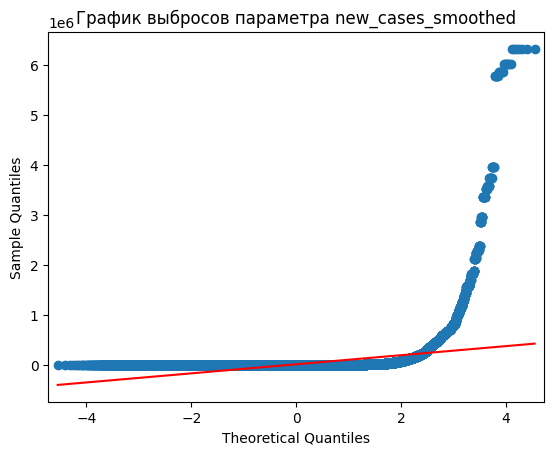

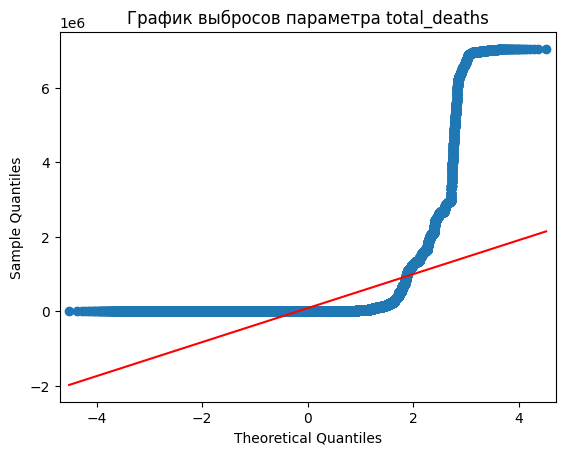

...

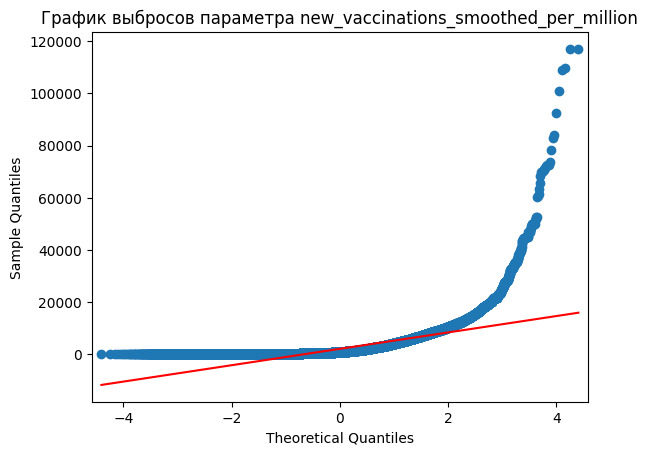

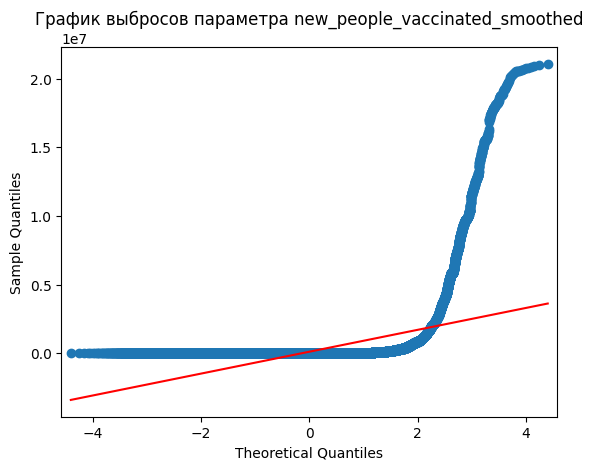

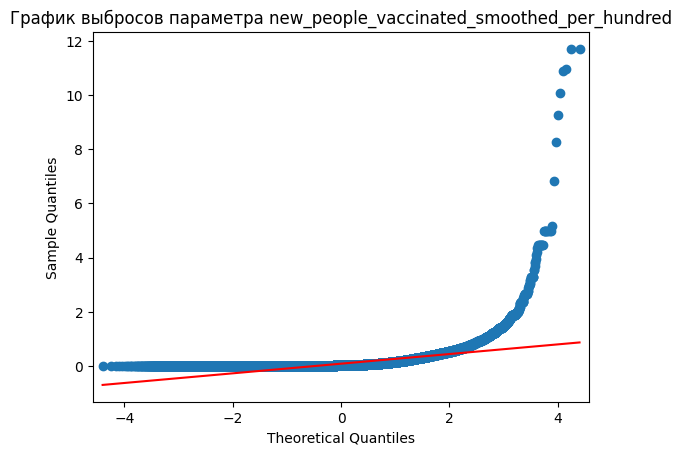

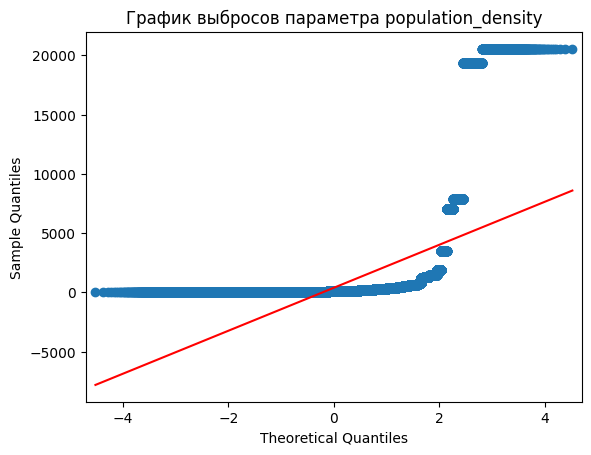

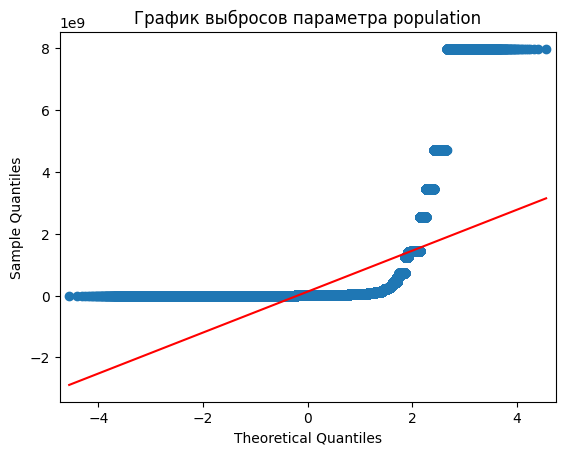

In [21]:
for column in check_this:
    try:
        qqplot((df[column].dropna()), line='s')
        plt.title(f'График выбросов параметра {column}')
        plt.show
    except Exception as e:
        print(f'Произошла ошибка: {e}')

В графиках выбросов можно увидеть, что только два параметра, total_tests и new_tests, имеют нормальное распределение данных. Проверим остальные параметры с помощью теста Шапиро-Уилка

In [22]:
for column in check_this:
    stat, p = stats.shapiro(df[column])
    if p < 0.05:
        print(f'Данные в {column} распределены ненормально (p-value: {p} < 0.05)')

C:\Users\Les\AppData\Local\Temp\ipykernel_17152\1541215007.py:2: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 383698.
  stat, p = stats.shapiro(df[column])


Данные в population распределены ненормально (p-value: 2.9893784141792696e-212 < 0.05)


Тест Шапиро-Уилка показал, что только параметр population имеет ненормальное рапсределение данных. Добавим данный параметр в список для удаления.

In [23]:
DeletedColumns.append("population")

# 1.4 Формирование дополнительных атрибутов

Начнём подогтовку датафрейма для обучения моделей. Создадим дополнительный параметр rt Удалим параметры с большим содержанием пропущенных записей, с большой отрицательной и положительной корреляцией, с ненормальным распределением данных и заполним нулевые значения. Преобразуем все текстовые параметры в числовые

Заполним все пропуски в <font color="green">new_cases, new_cases_smoothed, new_deaths, new_deaths_smoothed, new_cases_per_million, new_cases_smoothed_per_million, new_deaths_per_million, new_deaths_smoothed_per_million, new_tests, new_tests_smoothed, new_tests_per_thousand, new_tests_smoothed_per_thousand, new_vaccinations, new_vaccinations_smoothed, new_vaccinations_per_million, new_vaccinations_smoothed_per_million, new_people_vaccinated_smoothed, new_people_vaccinated_smoothed_per_hundred</font> на нулевые значения. Так как они показывают новые изменения, то вероятне всего пропущенными значениями являются нули.

In [57]:
#Создадим список, в который запишем все параметры на заполнение нулями
zeros=['new_cases', 'new_cases_smoothed', 'new_deaths', 'new_deaths_smoothed', 'new_cases_per_million', 'new_cases_smoothed_per_million', 'new_deaths_per_million', 'new_deaths_smoothed_per_million', 'new_tests', 'new_tests_smoothed', 'new_tests_per_thousand', 'new_tests_smoothed_per_thousand', 'new_vaccinations', 'new_vaccinations_smoothed', 'new_vaccinations_smoothed_per_million', 'new_people_vaccinated_smoothed', 'new_people_vaccinated_smoothed_per_hundred']
#Создадим датафрейм, который будет использован для обучения
end_df=df.copy(deep=True)
for column in zeros:
    end_df[column] = end_df[column].replace(np.nan, 0).bfill()

Заполним все пропуски <font color="green">total_cases</font> с помощью <font color="blue">new_cases</font>, так как в пределах одного уникального значения параметра <font color="red">location</font> <font color="green">total_cases</font> возрастает с каждым значением из <font color="blue">new_cases</font>

In [58]:
for location, group in end_df.groupby("location"):
    sum=0
    for index, row in group.iterrows():
        sum += row["new_cases"]
        end_df.loc[index, "total_cases"] = sum

Сформируем дополнительный атрибут RT. Коэффициент распространения коронавируса (RT) - это показатель, определяющий среднее количество людей, которых инфицирует один больной до его изоляции. Он рассчитывается на основе данных по приросту новых случаев за последние 8 суток. Коэффициент распространения коронавируса используется для принятия решений о переходе к первому, второму или третьему этапу снятия ограничений.

In [59]:
end_df['RT']= 0.0

In [ ]:
%%time
for i in range(len(end_df)-8):
    loc = end_df['location'][i]
    if(end_df['location'][i+8] == loc):
        end_df['RT'][i+8] = (end_df['total_cases'][i+7]+end_df['total_cases'][i+6]+end_df['total_cases'][i+5]+end_df['total_cases'][i+4])/(end_df['total_cases'][i+3]+end_df['total_cases'][i+2]+end_df['total_cases'][i+1]+end_df['total_cases'][i])
    else:
        for j in range(8):
            end_df['RT'][i] = 0
            i += 1

<timed exec>:4: RuntimeWarning: invalid value encountered in scalar divide
<timed exec>:4: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<timed exec>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

In [ ]:
end_df.info()

После повторного вывода информации о датасетн, можно увидет, что Rt имеет пропущенные значения.

Скорее всего значения NaN и бесконечные значения в <font color="green">RT</font> появились в результате деления на ноль, так что заполним их нулями.

In [ ]:
end_df["RT"]= end_df["RT"].replace( np.nan, 0).bfill()
end_df["RT"]= end_df["RT"].replace( -np.inf, 0).bfill()
end_df["RT"]= end_df["RT"].replace( np.inf, 0).bfill()

Удалим лишние параметры, которые мы решили убрать из датасета и сохранили в отдельный список, а также удалим все строковые значения и да, кроме <font color="green">location</font>, значения которого мы преобразуем в численный тип данных

In [ ]:
#Удалим параметры сохраненные в списке
end_df.drop(labels=DeletedColumns, axis=1, index=None, inplace=True)
#Удалим параметры типа object и datetime64
end_df.drop(labels="iso_code", axis=1, index=None, inplace=True) 
end_df.drop(labels="continent", axis=1, index=None, inplace=True)
#Сформируем новый параметр, который меняет значения location на численный тип данных
end_df['LocationID'] = pd.factorize(end_df.location)[0]
#Удалим оригинальный столбец location
end_df.drop(labels="location", axis=1, index=None, inplace=True)
#Преобразуем параметр date в три разных столбца и изменим тип данных на int 
end_df['year'] = end_df['date'].dt.year
end_df['month'] = end_df['date'].dt.month
end_df['day'] = end_df['date'].dt.day
#Удалим оригинальный параметр date
end_df.drop(labels="date", axis=1, index=None, inplace=True)
end_df.info()

Заполним все оставшиеся пропуски средним значением параметров соотвественно.

In [ ]:
for column in end_df.columns:
    print(column)
    print(end_df[column].isna().mean())
    print("Среднее значение пропусков до обработки")
    print()
    end_df[column] = end_df[column].replace(np.nan, end_df[column].mean()).fillna(method='ffill').fillna(0).astype(float)
    print("Среднее значение пропусков после обработки")
    print(end_df[column].isna().mean())
    print()
    print("------------------------------------------------------ ")
    print()

# 1.5 Кластеризация набора данных

Для скалирования данных воспользуемся методом на основе квантилей, так как он больше всего подходит для ассиметричных данных

In [ ]:
# Скалирование данных
from sklearn.preprocessing import PowerTransformer
scaler = PowerTransformer(method='yeo-johnson', standardize=True)
scaler.fit(end_df)
X_scale = scaler.transform(end_df)
scaled_data = pd.DataFrame(X_scale, columns=end_df.columns)

In [ ]:
# Уменьшение размерности датафрейма до 2-х измерений
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
pca.fit(scaled_data)

x_pca = pca.transform(scaled_data)
np.shape(x_pca)

Определение наилучшего количества кластеров по "методу локтя"

In [ ]:
from sklearn.cluster import KMeans
wgcc = []
for i in range(1,11):
    kmean = KMeans(n_clusters=i, init='k-means++', random_state=0)
    kmean.fit(x_pca)
    wgcc.append(kmean.inertia_)
plt.plot(range(1,11), wgcc);

По методу локтя видно, что лучше всего брать 3 или 4 кластера

## Кластеризация

Будут использоваться такие модели кластеризации как Kmeans, Birch и GaussianMixture, так как позволяют работать с большими объемами данных и выбирать количество кластеров.

__kmeans__ разбивает множество элементов векторного пространства на заранее известное число кластеров k.

Основная идея заключается в том, что на каждой итерации перевычисляется центр масс для каждого кластера, полученного на предыдущем шаге, затем векторы разбиваются на кластеры вновь в соответствии с тем, какой из новых центров оказался ближе по выбранной метрике

__Birch__ - это алгоритм интеллектуального анализа данных без учителя, используемый для осуществления иерархической кластеризации на наборах данных большого размера. Преимуществом BIRCH является возможность метода динамически кластеризовать по мере поступления многомерных метрических точек данных в попытке получить кластеризацию лучшего качества для имеющегося набора ресурсов.

__GaussianMixture__ - Модель смеси Гаусса (GMM) пытается найти смесь многомерных гауссовских распределений вероятностей, которые лучше всего моделируют любой входной набор данных. В простейшем случае ГММ могут использоваться для поиска кластеров таким же образом, как k-средние

In [ ]:
# Получение распределения от kmeans
kmeans = KMeans(n_clusters=3, init='k-means++', random_state=0)
label = kmeans.fit_predict(x_pca)

In [ ]:
# График распределения кластеров в kmeans
plt.figure(figsize=(12,8))
plt.scatter(x_pca[:,0],x_pca[:,1],c=label,cmap='rainbow', alpha=0.4)
plt.xlabel('First principal component')
plt.ylabel('Second Principal Component')

In [ ]:
# Просмотр того, как распределились данные 
labell = pd.Series(label)
labell.value_counts()

In [71]:
# Получение распределения от Birch
from sklearn.cluster import Birch

brc = Birch(n_clusters=3)
brc.fit(x_pca)

label2 = brc.predict(x_pca)

Text(0, 0.5, 'Second Principal Component')

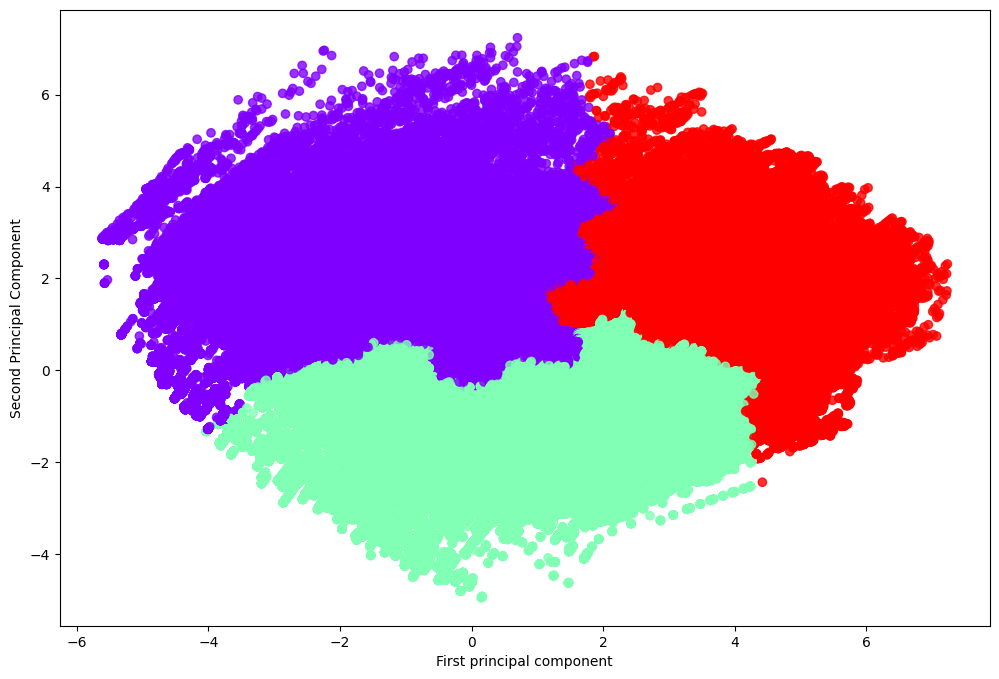

In [72]:
plt.figure(figsize=(12,8))
plt.scatter(x_pca[:,0],x_pca[:,1],c=label2,cmap='rainbow', alpha=0.8)
plt.xlabel('First principal component')
plt.ylabel('Second Principal Component')

In [73]:
# Просмотр того, как распределились данные 
labell2 = pd.Series(label2)
labell2.value_counts()

1    206234
0    119662
2     57802
Name: count, dtype: int64

In [74]:
# Получение распределения от GaussianMixture
from sklearn.mixture import GaussianMixture
gmm = GaussianMixture(3, covariance_type='full', random_state=0).fit(x_pca)

labels3 = gmm.predict(x_pca)

Text(0, 0.5, 'Second Principal Component')

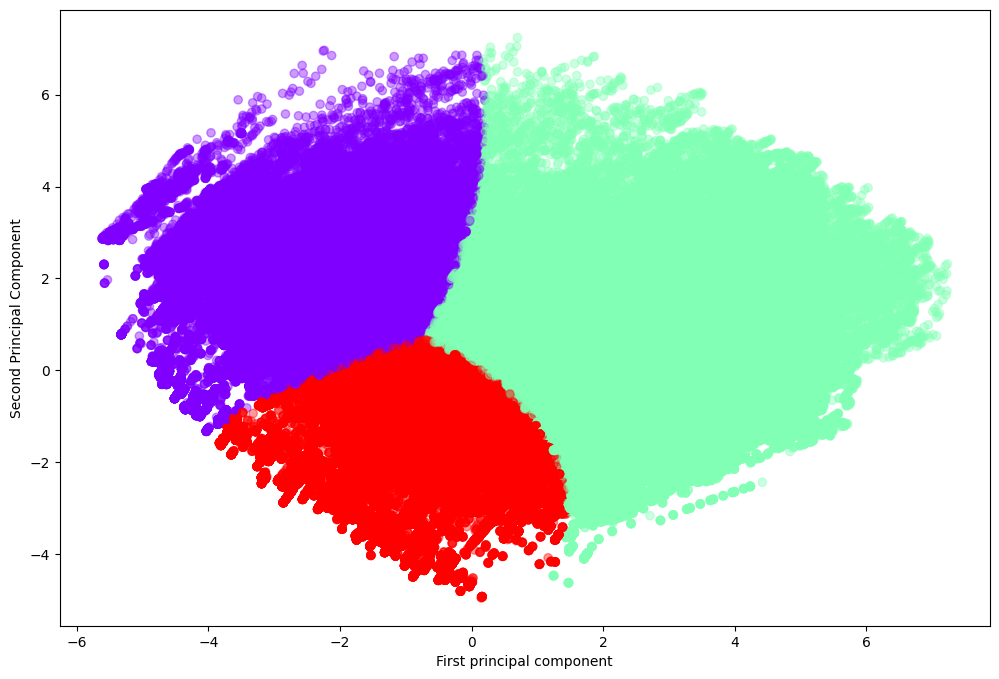

In [75]:
plt.figure(figsize=(12,8))
plt.scatter(x_pca[:,0],x_pca[:,1],c=labels3,cmap='rainbow', alpha=0.4)
plt.xlabel('First principal component')
plt.ylabel('Second Principal Component')

In [76]:
# Просмотр того, как распределились данные 
labell3 = pd.Series(labels3)
labell3.value_counts()

1    153533
2    142498
0     87667
Name: count, dtype: int64

## Метрики качества кластеризации


In [77]:
# Импорт метрик
from sklearn import metrics
from sklearn.metrics import adjusted_rand_score
from sklearn.metrics import adjusted_mutual_info_score
from sklearn.metrics import homogeneity_completeness_v_measure
from sklearn.metrics import silhouette_score
from sklearn.metrics import davies_bouldin_score

In [78]:
print('метрики kmeans = ' + str(metrics.calinski_harabasz_score(x_pca, label)) + '\n' +
     'метрики Birch = ' + str(metrics.calinski_harabasz_score(x_pca, label2)) + '\n' +
      'метрики GaussianMixture = ' + str(metrics.calinski_harabasz_score(x_pca, labels3)))

метрики kmeans = 411736.44408332015
метрики Birch = 240756.14786784875
метрики GaussianMixture = 391887.9447440134


In [79]:
print('метрики kmeans = ' + str(metrics.davies_bouldin_score(x_pca, label)) + '\n' +
     'метрики Birch = ' + str(metrics.davies_bouldin_score(x_pca, label2)) + '\n' +
      'метрики GaussianMixture = ' + str(metrics.davies_bouldin_score(x_pca, labels3)))

метрики kmeans = 0.7470517144954222
метрики Birch = 0.943786103340976
метрики GaussianMixture = 0.743164395236304


In [80]:
#print('метрики kmeans = ' + str(metrics.silhouette_score(x_pca, label)) + '\n' +
 #    'метрики Birch = ' + str(metrics.silhouette_score(x_pca, label2)) + '\n' +
  #    'метрики GaussianMixture = ' + str(metrics.silhouette_score(x_pca, labels3)))

Метрики показали разные результаты, однако kmeans показал хорошие средние показатели, поэтому добавим его результаты в датафрейм.

In [81]:
end_df['cluster'] = label

In [82]:
end_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 383698 entries, 0 to 383697
Data columns (total 31 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   total_cases                                 383698 non-null  float64
 1   new_cases_smoothed                          383698 non-null  float64
 2   new_deaths                                  383698 non-null  float64
 3   new_deaths_smoothed                         383698 non-null  float64
 4   total_cases_per_million                     383698 non-null  float64
 5   new_cases_per_million                       383698 non-null  float64
 6   new_cases_smoothed_per_million              383698 non-null  float64
 7   total_deaths_per_million                    383698 non-null  float64
 8   new_deaths_per_million                      383698 non-null  float64
 9   new_deaths_smoothed_per_million             383698 non-null  float64
 

# 1.6 Подготовка отчета

## 1.6.1 Парсинг данных

1. Подключили библиотеки для работы.
2. Загрузили данные с гитхаба.
3. Вывели данные.

Загрузили библиотеки и набор данных для дальнейшей обработки.

## 1.6.2 Формирование структуры набора данных

1. Вывели х-ки данных
2. Создали и добавили в список для удаления параметры с пропущенными значениями
3. Сделали корреляцию данных и вывели heatmap
4. Добавили данные с большой корреляцией в список для удаления

Сделали первичный анализ данных, а так же создали список для параметров на удаление, в который добавили параметры с пропущенными значениями и высокой  корреляцией 

##  1.6.3 Описание структуры набора данных

1. Вывели описание данных
2. Вывели графики распределения плотности
3. Вывели графики распределения выбросов для выбранных параметров
4. Сделали тест Шапиро-Уилка
5. Добавили в список для удаления параметры с ненормальным распределением данных

Вывели графики распределения данных и графики выбросов. Параметры с ненормальным распределением данных добавили в список на удаление. 

## 1.6.4 Формирование дополнительных атрибутов

1. Заполнили параметры с новыми случаями нулевыми значениями
2. Заполнили total_cases
3. Создали дополнительный атрибут RT
4. Удалили из датасета параметры, которые были сохранены в списке, и праметры типа object
5. Преобразовали параметр location в численный тип
6. Заменили пропущенные значения оставшихся параметров средним значением

Подготовили данные для обучения модели, удалив параметры из списка и заполнив пропущенные значения. Сформировали дополнительный атрибут для отслеживания новых случаев заболевания.

## 1.6.5 Формирование дополнительных атрибутов

1. Скалирование данных методом на основе квантилей
2. Вывели график "метода локтя" для определения количества кластеров
3. Провёл кластеризацию методом Kmeans.
4. Вывел график распределения кластеров Kmeans.
5. Провёл кластеризацию методом Birch.
6. Вывел график распределения кластеров Birch.
7. Провёл кластеризацию методом GaussianMixture.
8. Вывел график распределения кластеров GaussianMixture.
9. Использовали метрику качества кластеризации Калински-Харабаша
10. Использовали метрику качества кластеризации Дэвиса-Булдина
11. Использовали метрику качества кластеризации Коэффициент силуэта


Провели обучение обучение трёх моделей и с помощью метрик выбрали модель Kmeans для дальнейшей работы.

Подгтовим отчёт по работе

In [83]:
import zipfile # для архивации
import nbformat
from nbconvert import HTMLExporter

# Записать DataFrame в CSV файл
csv_file = 'data2.csv' # Имя файла, который мы хотим создать
data.to_csv(csv_file, index=False)

# Создание переменной с файлом notebook'a
ipynb_file = 'Damir_Session2.ipynb'

# Конвертирование .ipynb в .html
html_exporter = HTMLExporter()
html_exporter.template_name = 'classic'

# Загрузить содержимое .ipynb файла
with open(ipynb_file, 'r', encoding='utf-8') as f:
    notebook_content = nbformat.reads(f.read(), as_version=4)
    
# Конвертирование в HTML
(body, resources) = html_exporter.from_notebook_node(notebook_content)

# Запись HTML в файл
html_file = ipynb_file.replace('.ipynb', '.html')
with open(html_file, 'w', encoding='utf-8') as f:
    f.write(body)
    
# Создание строки со содержанием для README.md
readme_content = """
## Содержимое архива

**data2.csv** - результирующий набор данных, полученный в конце первой сессии.
**Damir_Session2.ipynb** - файл в формате ipynb, содержащий визуальную часть и логическую (код) часть, в котором присутствует полный ход работы на первой сессии.
**Damir_Session2.html** - файл в формате html, содержащий визуальную часть и логическую (код) часть, в котором присутствует полный ход работы на первой сессии.
**README.md** - файл, в котором содержится описание всех файлов в zip-архиве Data.zip.
"""

# Создание файла README.md и запись в него содержимого
readme_file = 'README.md'
with open(readme_file, 'w', encoding='utf-8') as f:
    f.write(readme_content.strip())

# Архивировать CSV файл в ZIP-архив
zip_file = 'Data.zip' # Имя создаваемого архива

# Создание архива и добавление файлов
with zipfile.ZipFile(zip_file, 'w') as zip:
    zip.write(csv_file, arcname=csv_file)
    zip.write(ipynb_file, arcname=ipynb_file)
    zip.write(html_file, arcname=html_file)
    zip.write(readme_file, arcname=readme_file)

# После этого 'Data.zip' будет содержать 'data2.csv', 'Damir_Session2.ipynb', 'Damir_Session2.html' и 'README.md'